Тема исследования: Прогнозирование конечных свойств новых материалов (композиционных материалов)

Цель исследования: построение моделей прогнозирования следующих параметров: «модуль упругости при растяжении»; «прочность при растяжении»; «соотношение матрица-наполнитель» 

In [2]:
import warnings
warnings.filterwarnings("default", category=FutureWarning)
warnings.simplefilter(action='ignore', category=FutureWarning)


In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
import seaborn as sns
import plotly.express as px
import tensorflow as tf
import sklearn

from sklearn import linear_model
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import LinearRegression, LogisticRegression, SGDRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_percentage_error, mean_absolute_error
from sklearn.model_selection import train_test_split, GridSearchCV, KFold, cross_val_score
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn import preprocessing
from sklearn.preprocessing import Normalizer, LabelEncoder, MinMaxScaler, StandardScaler
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor

from tensorflow import keras as keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Flatten, Dropout, BatchNormalization, Activation
from pandas import read_excel, DataFrame, Series
from keras.wrappers.scikit_learn import KerasClassifier, KerasRegressor
from tensorflow.keras.models import Sequential
from numpy.random import seed
from scipy import stats
import warnings
warnings.filterwarnings("ignore")

Загружаем данные


In [116]:
# загружаем файлы
df1 = pd.read_excel('./Data/X_bp.xlsx') 
df2 = pd.read_excel('./Data/X_nup.xlsx')
# сморим размерность
df1.shape,df2.shape 


((1023, 11), (1040, 4))

In [117]:
# объединяем датасеты
df = pd.merge(df1,df2,how = 'inner')
df.drop(['Unnamed: 0'], axis=1, inplace=True)
# 13 столбцов и 1023 строки
df.shape

(1023, 13)

In [118]:
# устраняем строки без индекса
df.dropna(inplace = True)
df.head()


,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
0,1.857143,2030.0,738.736842,30.00,22.267857,100.000000,210.0,70.0,3000.0,220.0,0,4.0,57.0
1,1.857143,2030.0,738.736842,50.00,23.750000,284.615385,210.0,70.0,3000.0,220.0,0,4.0,60.0
2,1.857143,2030.0,738.736842,49.90,33.000000,284.615385,210.0,70.0,3000.0,220.0,0,4.0,70.0
3,1.857143,2030.0,738.736842,129.00,21.250000,300.000000,210.0,70.0,3000.0,220.0,0,5.0,47.0
4,2.771331,2030.0,753.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,57.0


In [119]:
df.shape,df.columns

((1023, 13),
 Index(['Соотношение матрица-наполнитель', 'Плотность, кг/м3',
        'модуль упругости, ГПа', 'Количество отвердителя, м.%',
        'Содержание эпоксидных групп,%_2', 'Температура вспышки, С_2',
        'Поверхностная плотность, г/м2', 'Модуль упругости при растяжении, ГПа',
        'Прочность при растяжении, МПа', 'Потребление смолы, г/м2',
        'Угол нашивки, град', 'Шаг нашивки', 'Плотность нашивки'],
       dtype='object'))

In [120]:
print(df.shape)
df.head(1)

(1023, 13)


,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
0,1.857143,2030.0,738.736842,30.0,22.267857,100.0,210.0,70.0,3000.0,220.0,0,4.0,57.0


Анализируем таблицу


In [252]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1023 entries, 0 to 1022
Data columns (total 13 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Соотношение матрица-наполнитель       1023 non-null   float64
 1   Плотность, кг/м3                      1023 non-null   float64
 2   модуль упругости, ГПа                 1023 non-null   float64
 3   Количество отвердителя, м.%           1023 non-null   float64
 4   Содержание эпоксидных групп,%_2       1023 non-null   float64
 5   Температура вспышки, С_2              1023 non-null   float64
 6   Поверхностная плотность, г/м2         1023 non-null   float64
 7   Модуль упругости при растяжении, ГПа  1023 non-null   float64
 8   Прочность при растяжении, МПа         1023 non-null   float64
 9   Потребление смолы, г/м2               1023 non-null   float64
 10  Угол нашивки, град                    1023 non-null   int64  
 11  Шаг нашивки      

In [253]:
# Описательная статистика 
df.describe() 


,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
count,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000,1023.000000
mean,2.930366,1975.734888,739.923233,110.570769,22.244390,285.882151,482.731833,73.328571,2466.922843,218.423144,44.252199,6.899222,57.153929
std,0.913222,73.729231,330.231581,28.295911,2.406301,40.943260,281.314690,3.118983,485.628006,59.735931,45.015793,2.563467,12.350969
min,0.389403,1731.764635,2.436909,17.740275,14.254985,100.000000,0.603740,64.054061,1036.856605,33.803026,0.000000,0.000000,0.000000
25%,2.317887,1924.155467,500.047452,92.443497,20.608034,259.066528,266.816645,71.245018,2135.850448,179.627520,0.000000,5.080033,49.799212
50%,2.906878,1977.621657,739.664328,110.564840,22.230744,285.896812,451.864365,73.268805,2459.524526,219.198882,0.000000,6.916144,57.341920
75%,3.552660,2021.374375,961.812526,129.730366,23.961934,313.002106,693.225017,75.356612,2767.193119,257.481724,90.000000,8.586293,64.944961
max,5.591742,2207.773481,1911.536477,198.953207,33.000000,413.273418,1399.542362,82.682051,3848.436732,414.590628,90.000000,14.440522,103.988901


In [254]:
df.describe().T


,count,mean,std,min,25%,50%,75%,max
Соотношение матрица-наполнитель,1023.0,2.930366,0.913222,0.389403,2.317887,2.906878,3.552660,5.591742
"Плотность, кг/м3",1023.0,1975.734888,73.729231,1731.764635,1924.155467,1977.621657,2021.374375,2207.773481
"модуль упругости, ГПа",1023.0,739.923233,330.231581,2.436909,500.047452,739.664328,961.812526,1911.536477
"Количество отвердителя, м.%",1023.0,110.570769,28.295911,17.740275,92.443497,110.564840,129.730366,198.953207
"Содержание эпоксидных групп,%_2",1023.0,22.244390,2.406301,14.254985,20.608034,22.230744,23.961934,33.000000
"Температура вспышки, С_2",1023.0,285.882151,40.943260,100.000000,259.066528,285.896812,313.002106,413.273418
"Поверхностная плотность, г/м2",1023.0,482.731833,281.314690,0.603740,266.816645,451.864365,693.225017,1399.542362
"Модуль упругости при растяжении, ГПа",1023.0,73.328571,3.118983,64.054061,71.245018,73.268805,75.356612,82.682051
"Прочность при растяжении, МПа",1023.0,2466.922843,485.628006,1036.856605,2135.850448,2459.524526,2767.193119,3848.436732
"Потребление смолы, г/м2",1023.0,218.423144,59.735931,33.803026,179.627520,219.198882,257.481724,414.590628


In [255]:
#  Делаем подсчет уникальных значений по столбцам 

df.nunique()


Соотношение матрица-наполнитель         1014
Плотность, кг/м3                        1013
модуль упругости, ГПа                   1020
Количество отвердителя, м.%             1005
Содержание эпоксидных групп,%_2         1004
Температура вспышки, С_2                1003
Поверхностная плотность, г/м2           1004
Модуль упругости при растяжении, ГПа    1004
Прочность при растяжении, МПа           1004
Потребление смолы, г/м2                 1003
Угол нашивки, град                         2
Шаг нашивки                              989
Плотность нашивки                        988
dtype: int64

In [256]:
df.isna()# маска с пропущенными значениями


,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
0,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1018,False,False,False,False,False,False,False,False,False,False,False,False,False
1019,False,False,False,False,False,False,False,False,False,False,False,False,False
1020,False,False,False,False,False,False,False,False,False,False,False,False,False
1021,False,False,False,False,False,False,False,False,False,False,False,False,False


In [257]:
df.isna().sum() # подсчет пропущенных значений 


Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки, град                      0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

In [258]:
df.duplicated().sum() # Поиск дубликатов

0

In [259]:
# Коэффициенты корреляции Пирсона.

df.corr(method ='pearson')


,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
Соотношение матрица-наполнитель,1.000000,0.003841,0.031700,-0.006445,0.019766,-0.004776,-0.006272,-0.008411,0.024148,0.072531,-0.031073,0.036437,-0.004652
"Плотность, кг/м3",0.003841,1.000000,-0.009647,-0.035911,-0.008278,-0.020695,0.044930,-0.017602,-0.069981,-0.015937,-0.068474,-0.061015,0.080304
"модуль упругости, ГПа",0.031700,-0.009647,1.000000,0.024049,-0.006804,0.031174,-0.005306,0.023267,0.041868,0.001840,-0.025417,-0.009875,0.056346
"Количество отвердителя, м.%",-0.006445,-0.035911,0.024049,1.000000,-0.000684,0.095193,0.055198,-0.065929,-0.075375,0.007446,0.038570,0.014887,0.017248
"Содержание эпоксидных групп,%_2",0.019766,-0.008278,-0.006804,-0.000684,1.000000,-0.009769,-0.012940,0.056828,-0.023899,0.015165,0.008052,0.003022,-0.039073
"Температура вспышки, С_2",-0.004776,-0.020695,0.031174,0.095193,-0.009769,1.000000,0.020121,0.028414,-0.031763,0.059954,0.020695,0.025795,0.011391
"Поверхностная плотность, г/м2",-0.006272,0.044930,-0.005306,0.055198,-0.012940,0.020121,1.000000,0.036702,-0.003210,0.015692,0.052299,0.038332,-0.049923
"Модуль упругости при растяжении, ГПа",-0.008411,-0.017602,0.023267,-0.065929,0.056828,0.028414,0.036702,1.000000,-0.009009,0.050938,0.023003,-0.029468,0.006476
"Прочность при растяжении, МПа",0.024148,-0.069981,0.041868,-0.075375,-0.023899,-0.031763,-0.003210,-0.009009,1.000000,0.028602,0.023398,-0.059547,0.019604
"Потребление смолы, г/м2",0.072531,-0.015937,0.001840,0.007446,0.015165,0.059954,0.015692,0.050938,0.028602,1.000000,-0.015334,0.013394,0.012239


In [260]:
# Коэффициенты ранговой корреляции Кендалла.

df.corr(method = 'kendall') 


,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
Соотношение матрица-наполнитель,1.000000,-0.003135,0.021247,0.001410,0.010180,-0.009480,-0.002060,-0.004157,0.011614,0.035145,-0.021395,0.022723,0.002788
"Плотность, кг/м3",-0.003135,1.000000,-0.008059,-0.021963,-0.007758,-0.019947,0.037302,-0.021151,-0.047426,-0.017079,-0.051525,-0.031220,0.052935
"модуль упругости, ГПа",0.021247,-0.008059,1.000000,0.022382,0.002351,0.021028,-0.000442,0.005458,0.022959,0.005169,-0.031695,-0.008305,0.049347
"Количество отвердителя, м.%",0.001410,-0.021963,0.022382,1.000000,0.000010,0.059034,0.033110,-0.043140,-0.046507,-0.003677,0.024690,0.006232,0.016607
"Содержание эпоксидных групп,%_2",0.010180,-0.007758,0.002351,0.000010,1.000000,-0.002170,-0.006859,0.041994,-0.013441,0.009756,0.004668,-0.004539,-0.021968
"Температура вспышки, С_2",-0.009480,-0.019947,0.021028,0.059034,-0.002170,1.000000,0.017196,0.016481,-0.019106,0.035313,0.017880,0.029552,0.005268
"Поверхностная плотность, г/м2",-0.002060,0.037302,-0.000442,0.033110,-0.006859,0.017196,1.000000,0.024051,-0.005099,-0.004446,0.045452,0.025514,-0.022320
"Модуль упругости при растяжении, ГПа",-0.004157,-0.021151,0.005458,-0.043140,0.041994,0.016481,0.024051,1.000000,-0.006599,0.034814,0.022431,-0.010024,-0.002600
"Прочность при растяжении, МПа",0.011614,-0.047426,0.022959,-0.046507,-0.013441,-0.019106,-0.005099,-0.006599,1.000000,0.013580,0.020609,-0.048049,0.009821
"Потребление смолы, г/м2",0.035145,-0.017079,0.005169,-0.003677,0.009756,0.035313,-0.004446,0.034814,0.013580,1.000000,-0.002402,0.005962,0.010792


Рисуем гистограммы

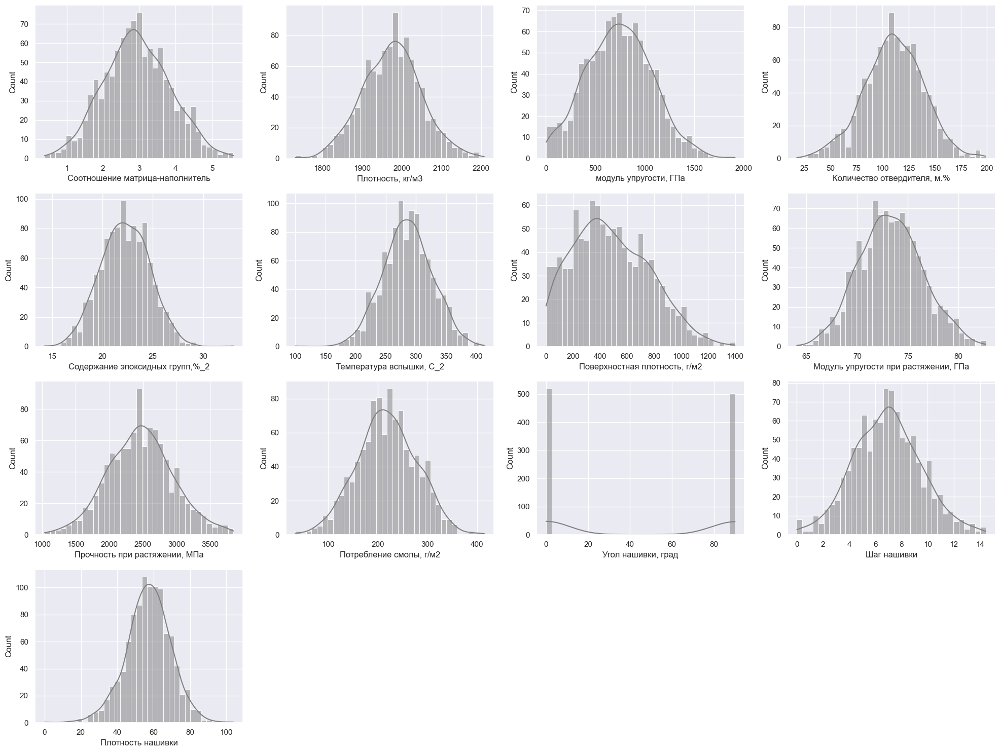

In [261]:
from matplotlib.colorbar import colorbar_factory
def histogram (df, n_rows, n_cols):
    fig=plt.figure(figsize=(20, 15))
    for i, column in enumerate(df.columns):
        ax=fig.add_subplot(n_rows,n_cols,i+1)
        sns.histplot(data=df, x=column, kde=True, bins=35, color = 'grey')
    fig.tight_layout()
    plt.show()

histogram(df, 4, 4)


Попарные графики рассеяния

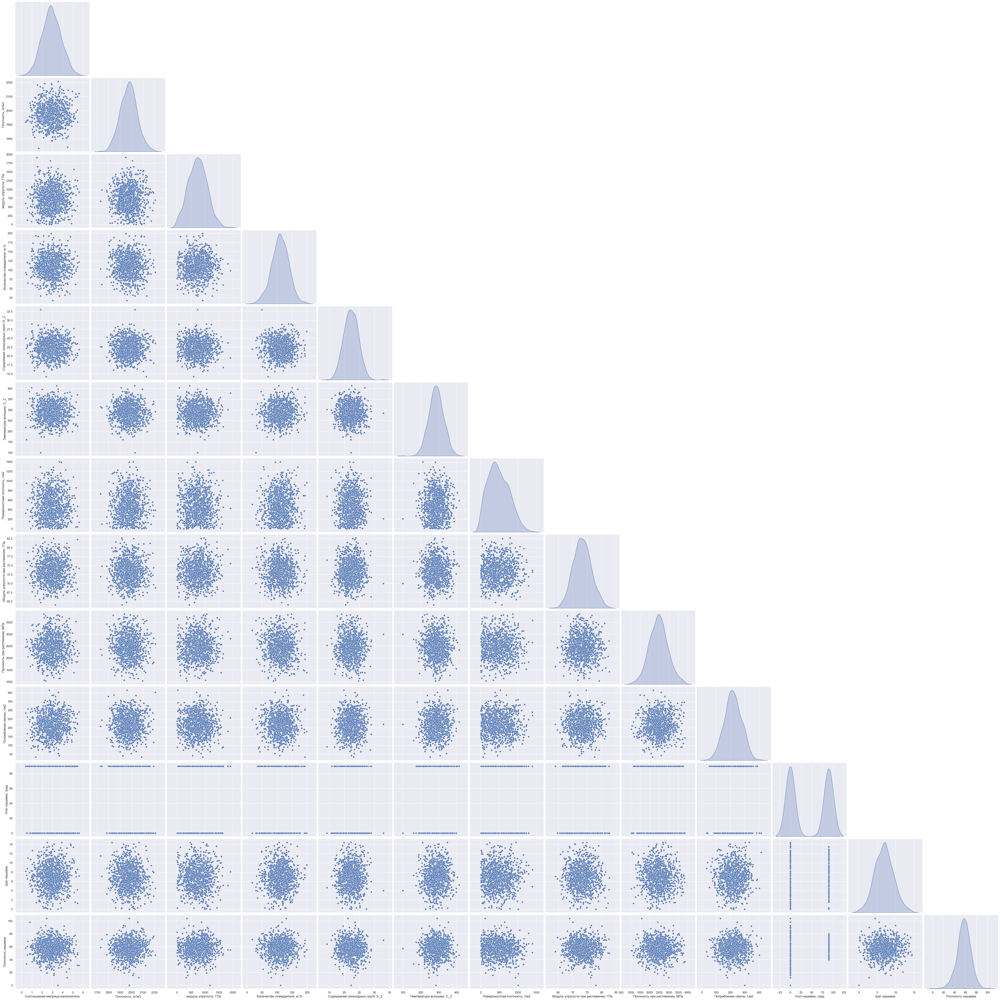

In [262]:
sns.pairplot(df, height=4, diag_kind='kde', corner = True);

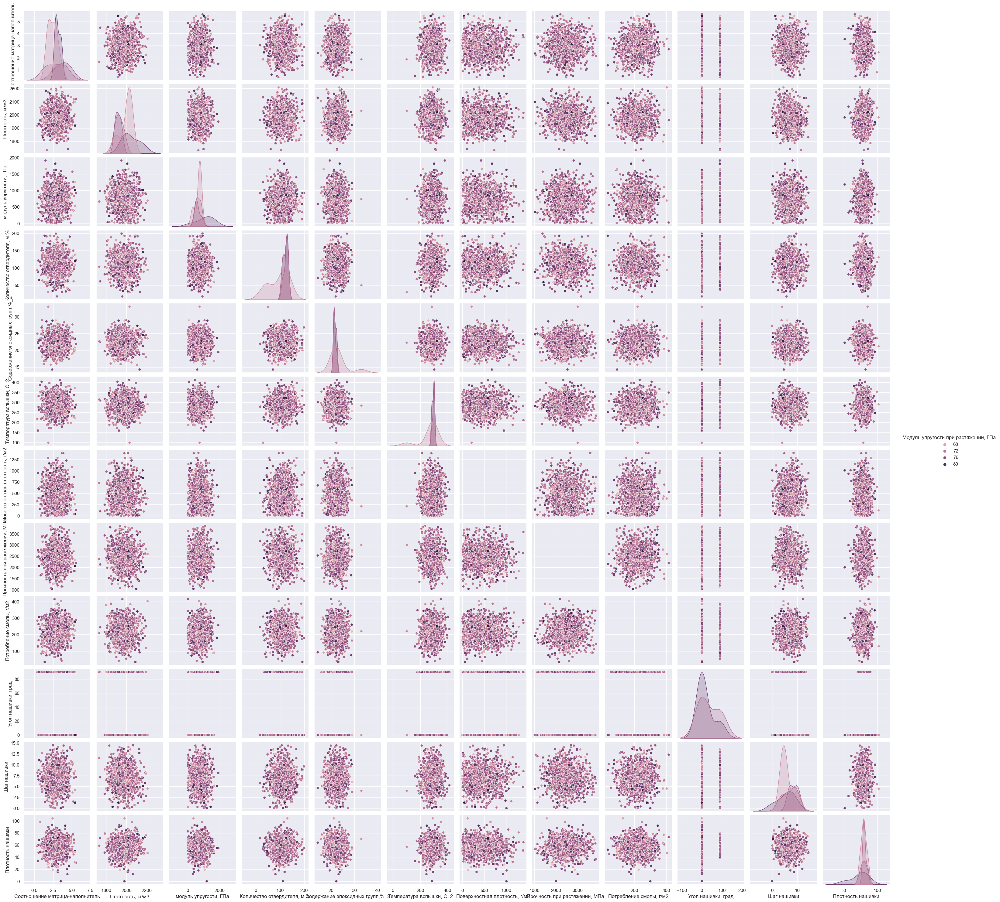

In [263]:
sns.pairplot(df, hue="Модуль упругости при растяжении, ГПа")


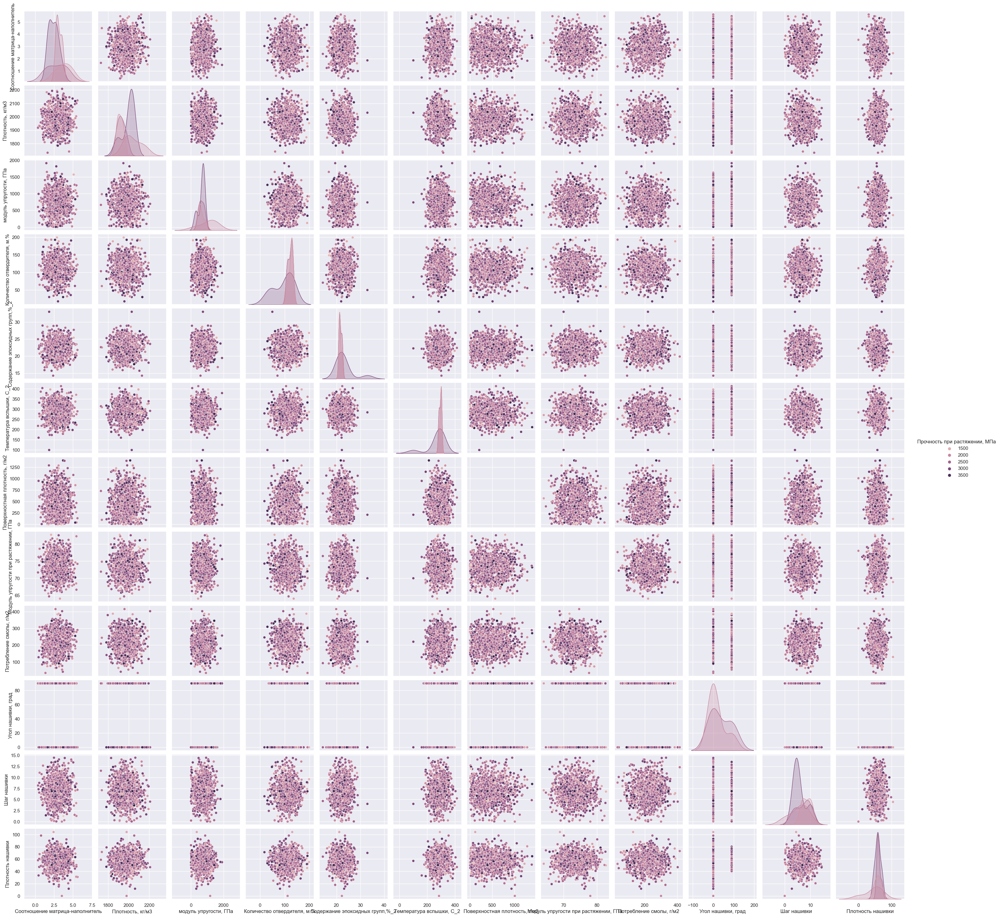

In [264]:
sns.pairplot(df, hue="Прочность при растяжении, МПа")

Диаграмма "Ящик с усами" (Boxplot)

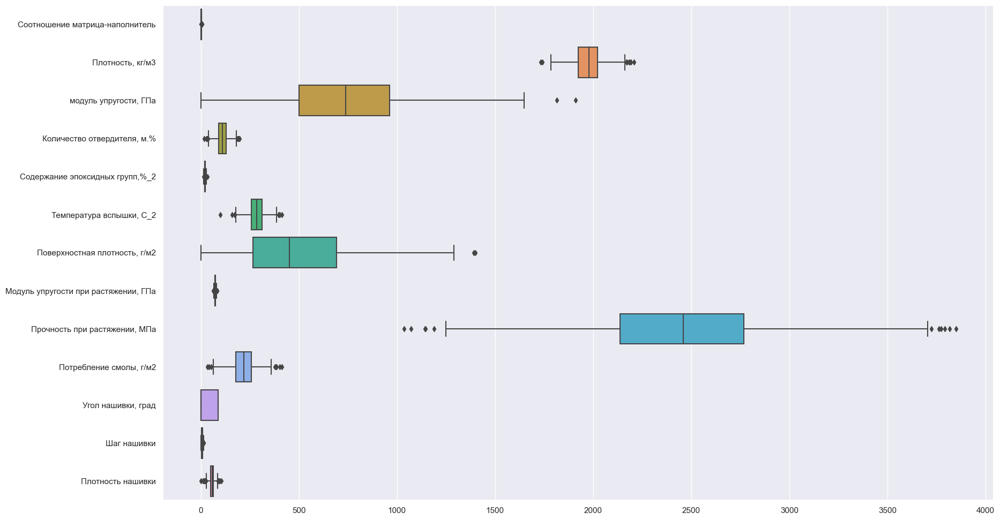

In [322]:
sns.boxplot(data = df, orient="h")
plt.show()

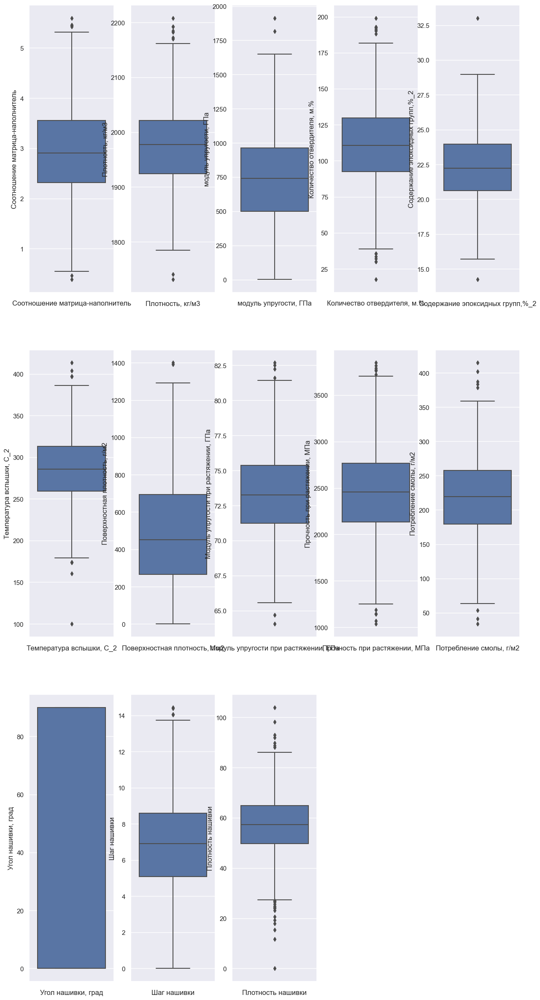

In [266]:
def box_pl2(df):
  col = 5  # столбцы
  k = 1  # счетчик
  row = 3  # строки

  fig = plt.figure(figsize=(15, 30))

  for i in df.columns:
      plt.subplot(row, col, k)
      plt.xlabel(i)
      sns.boxplot(y = df[i])
      k+=1
    
  plt.show()
box_pl2(df)

# Приводим столбец к 0 и 1

Угол нашивки, град

In [121]:
# Приводим столбец к 0 и 1
df = df.replace({'Угол нашивки, град': {0.0 : 0, 90.0 : 1}})
df.iloc[:,10] = df.iloc[:,10].astype(int)
df.iloc[:,10]


0       0
1       0
2       0
3       0
4       0
       ..
1018    1
1019    1
1020    1
1021    1
1022    1
Name: Угол нашивки, град, Length: 1023, dtype: int64

удаление методом межквартильных расстояний или 3сигм

In [268]:
# Метод 3-х сигм

metod = 0
count = []

for column in df:
    d = df.loc[:, [column]]
    zscore = (df[column] - df[column].mean()) / df[column].std()
    d['3s'] = zscore.abs() > 3
    metod += d['3s'].sum()
    count.append(d['3s'].sum())
    print(column,'3s', ': ', d['3s'].sum())
print('Выбросы: ', metod)

Соотношение матрица-наполнитель 3s :  0
Плотность, кг/м3 3s :  3
модуль упругости, ГПа 3s :  2
Количество отвердителя, м.% 3s :  2
Содержание эпоксидных групп,%_2 3s :  2
Температура вспышки, С_2 3s :  3
Поверхностная плотность, г/м2 3s :  2
Модуль упругости при растяжении, ГПа 3s :  0
Прочность при растяжении, МПа 3s :  0
Потребление смолы, г/м2 3s :  3
Угол нашивки, град 3s :  0
Шаг нашивки 3s :  0
Плотность нашивки 3s :  7
Выбросы:  24


In [390]:
# Межквартильне расстояния

metod = 0
count = []

for column in df:
    d = df.loc[:, [column]]
    q1 = np.quantile(df[column], 0.25)
    q3 = np.quantile(df[column], 0.75)
    iqr = q3 - q1
    lower = q1 - 1.5 * iqr
    upper = q3 + 1.5 * iqr
    d['iq'] = (df[column] <= lower) | (df[column] >= upper)
    metod += d['iq'].sum()
    count.append(d['iq'].sum())
    print(column, ': ', d['iq'].sum())
print('Выбросы: ', metod)

Соотношение матрица-наполнитель :  6
Плотность, кг/м3 :  9
модуль упругости, ГПа :  2
Количество отвердителя, м.% :  14
Содержание эпоксидных групп,%_2 :  2
Температура вспышки, С_2 :  8
Поверхностная плотность, г/м2 :  2
Модуль упругости при растяжении, ГПа :  6
Прочность при растяжении, МПа :  11
Потребление смолы, г/м2 :  8
Угол нашивки, град :  0
Шаг нашивки :  4
Плотность нашивки :  21
Выбросы:  93


Выбран метод межквантильных интервалов по результатам тестов

In [122]:
# убираем выбросы

dropen = ["Соотношение матрица-наполнитель",
                 "Плотность, кг/м3",
                 "модуль упругости, ГПа",
                 "Количество отвердителя, м.%",
                 "Содержание эпоксидных групп,%_2",
                 "Температура вспышки, С_2",
                 "Поверхностная плотность, г/м2",
                 "Модуль упругости при растяжении, ГПа",
                 "Прочность при растяжении, МПа",
                 "Потребление смолы, г/м2",
                 "Шаг нашивки",
                 "Плотность нашивки"]

for i in dropen:
    q75, q25 = np.percentile(df.loc[:,i], [75,25])
    intr_qr = q75 - q25
    max = q75 + (1.5 * intr_qr) # выбрана размашка 1,5
    min = q25 - (1.5 * intr_qr)
    df.loc[df[i] < min, i] = np.nan
    df.loc[df[i] > max, i] = np.nan

df_n = df.dropna(axis=0)
df_n.shape



(936, 13)

"Ящик с усами" после удаления выбросов

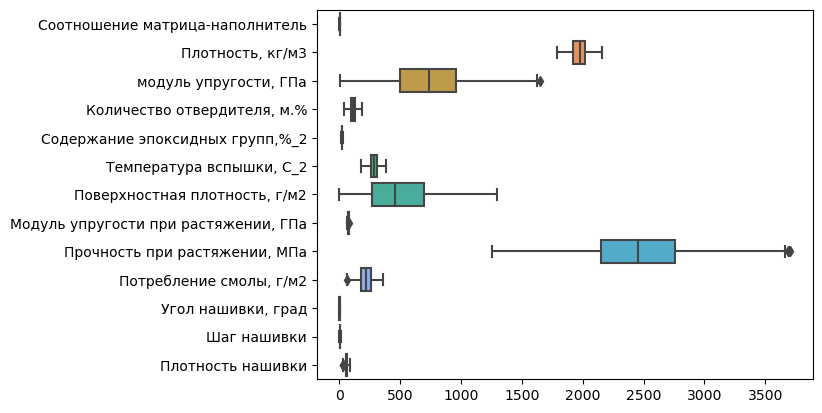

In [10]:
# Смотрим что получилось
sns.boxplot(data = df_n, orient="h")
plt.show()

In [11]:
df_n.shape

(936, 13)

Оценка плотности ядра

In [123]:
def plt_kde(df_n):
  fig, ax = plt.subplots(figsize=(20, 10))
  df_n.plot(kind='kde', ax=ax)

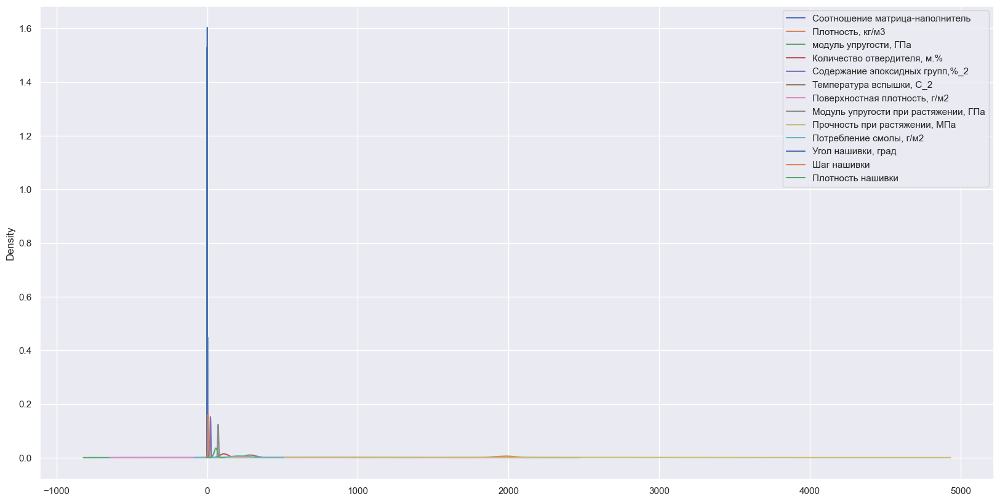

In [393]:
plt_kde(df_n)


Нормализуем данные

In [127]:

#Нормализация MinMaxScaler() 
scaler = preprocessing.MinMaxScaler()
col = df_n.columns
result = scaler.fit_transform(df_n)
minmax = pd.DataFrame(result, columns = col)
minmax.describe()
df_n.head()


,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
1,1.857143,2030.0,738.736842,50.00,23.750000,284.615385,210.0,70.0,3000.0,220.0,0,4.0,60.0
3,1.857143,2030.0,738.736842,129.00,21.250000,300.000000,210.0,70.0,3000.0,220.0,0,5.0,47.0
4,2.771331,2030.0,753.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,57.0
5,2.767918,2000.0,748.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,60.0
6,2.569620,1910.0,807.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,70.0


In [16]:
df_n.head().T

,0,1,2,3,4
Соотношение матрица-наполнитель,0.274768,0.274768,0.466552,0.465836,0.424236
"Плотность, кг/м3",0.651097,0.651097,0.651097,0.571539,0.332865
"модуль упругости, ГПа",0.447061,0.447061,0.455721,0.452685,0.488508
"Количество отвердителя, м.%",0.079153,0.630983,0.511257,0.511257,0.511257
"Содержание эпоксидных групп,%_2",0.607435,0.418887,0.495653,0.495653,0.495653
"Температура вспышки, С_2",0.509164,0.583596,0.509164,0.509164,0.509164
"Поверхностная плотность, г/м2",0.162230,0.162230,0.162230,0.162230,0.162230
"Модуль упругости при растяжении, ГПа",0.280303,0.280303,0.280303,0.280303,0.280303
"Прочность при растяжении, МПа",0.712590,0.712590,0.712590,0.712590,0.712590
"Потребление смолы, г/м2",0.529221,0.529221,0.529221,0.529221,0.529221


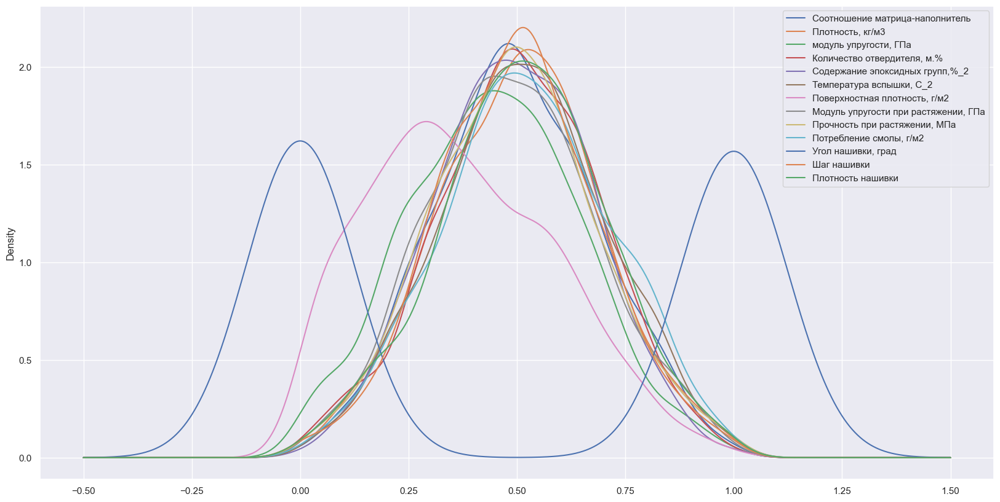

In [276]:
plt_kde(df_n)


Описательная статистика характеристик после нормализации

In [330]:
df_n.describe().T.round(2)

,count,mean,std,min,25%,50%,75%,max
Соотношение матрица-наполнитель,936.0,0.50,0.19,0.0,0.37,0.49,0.63,1.0
"Плотность, кг/м3",936.0,0.50,0.19,0.0,0.37,0.51,0.62,1.0
"модуль упругости, ГПа",936.0,0.45,0.20,0.0,0.30,0.45,0.58,1.0
"Количество отвердителя, м.%",936.0,0.50,0.19,0.0,0.38,0.51,0.64,1.0
"Содержание эпоксидных групп,%_2",936.0,0.49,0.18,0.0,0.37,0.49,0.62,1.0
"Температура вспышки, С_2",936.0,0.52,0.19,0.0,0.39,0.52,0.65,1.0
"Поверхностная плотность, г/м2",936.0,0.37,0.22,0.0,0.21,0.35,0.54,1.0
"Модуль упругости при растяжении, ГПа",936.0,0.49,0.19,0.0,0.36,0.49,0.62,1.0
"Прочность при растяжении, МПа",936.0,0.50,0.19,0.0,0.37,0.49,0.61,1.0
"Потребление смолы, г/м2",936.0,0.52,0.20,0.0,0.39,0.52,0.65,1.0


Оценим ящик с усами после нормализации

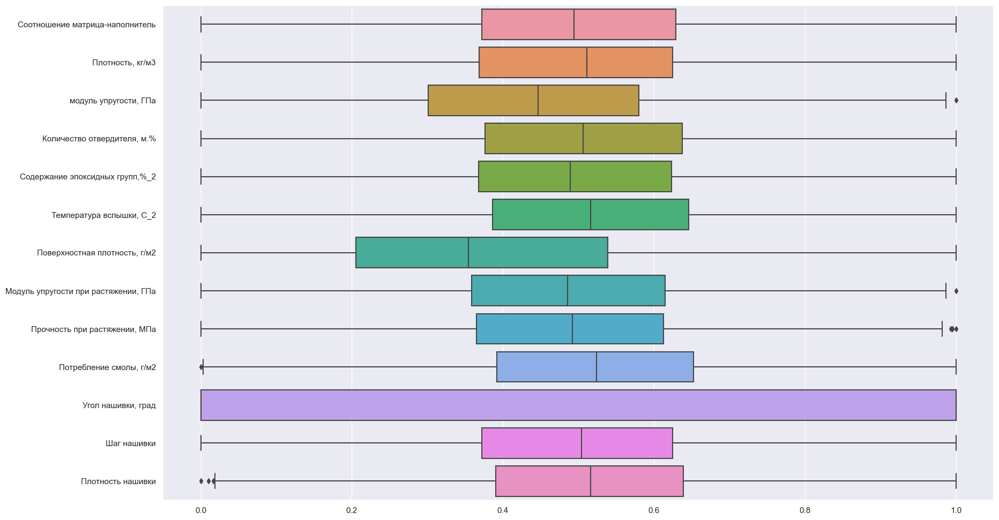

In [435]:
# Смотрим что получилось
sns.boxplot(data = df_n, orient="h")
plt.show()

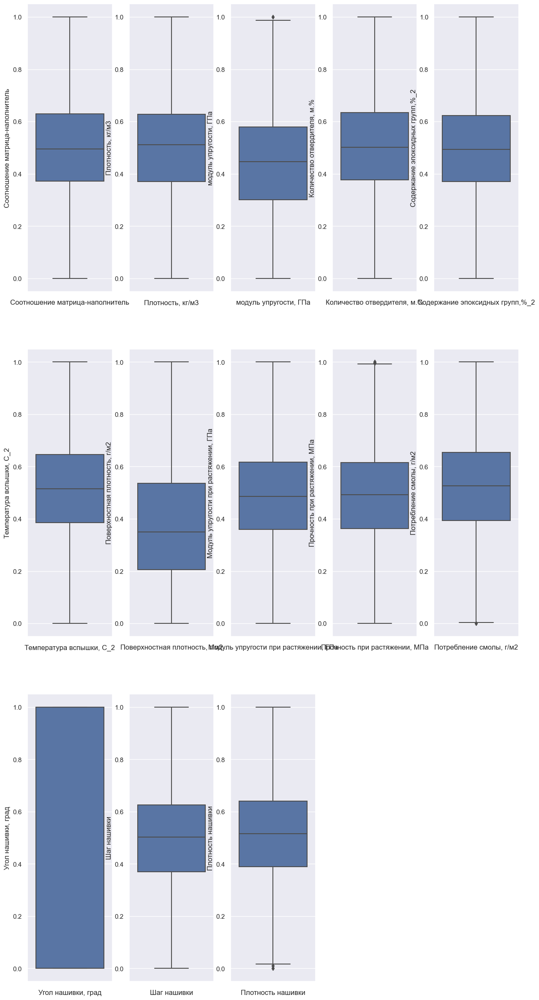

In [279]:
# Ящики c усами выбросы
#выбросы соответствуют нормальному распределению

box_pl2(df_n)

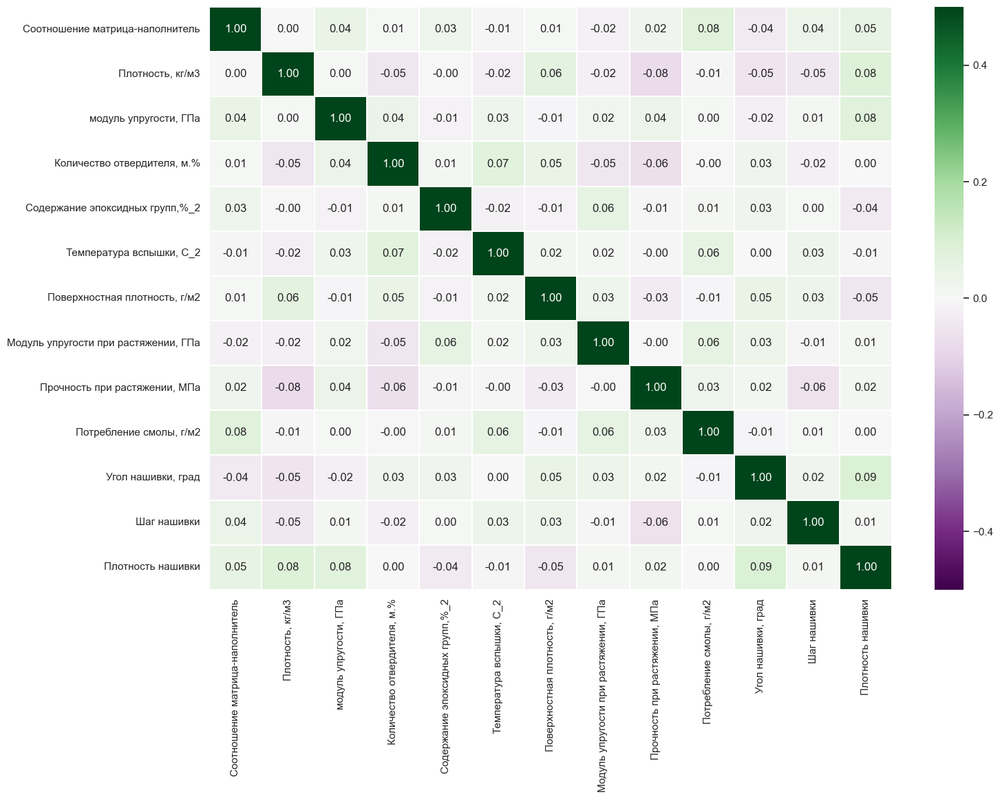

In [332]:
# Тепловая карта
corr = df_n.corr()
fig, ax = plt.subplots(figsize=(16, 11))
sns.heatmap(corr, vmin=-0.5, vmax=0.5, annot=True, fmt='.2f',cmap='PRGn', ax=ax, linewidths = 0.1)
plt.show()
# наблюдается зависимость между Плостностью и углом нашивки
# но она довольно слабая

<AxesSubplot:ylabel='Density'>

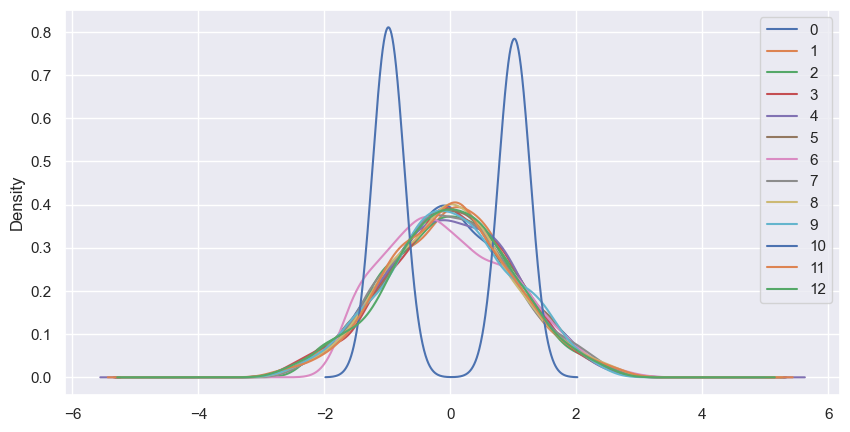

In [311]:
#Стандартизация и график по итогу далее мы ее не имспользуем остановился на минмаксе
stnd_minx = df_n
stnd_minx_res = preprocessing.StandardScaler().fit(stnd_minx)
stnd_minx_res = stnd_minx_res.transform(stnd_minx)
stnd_minx_res = pd.DataFrame(stnd_minx_res)
fig, ax = plt.subplots(figsize = (10, 5))
stnd_minx_res.plot(kind = 'kde', ax = ax)


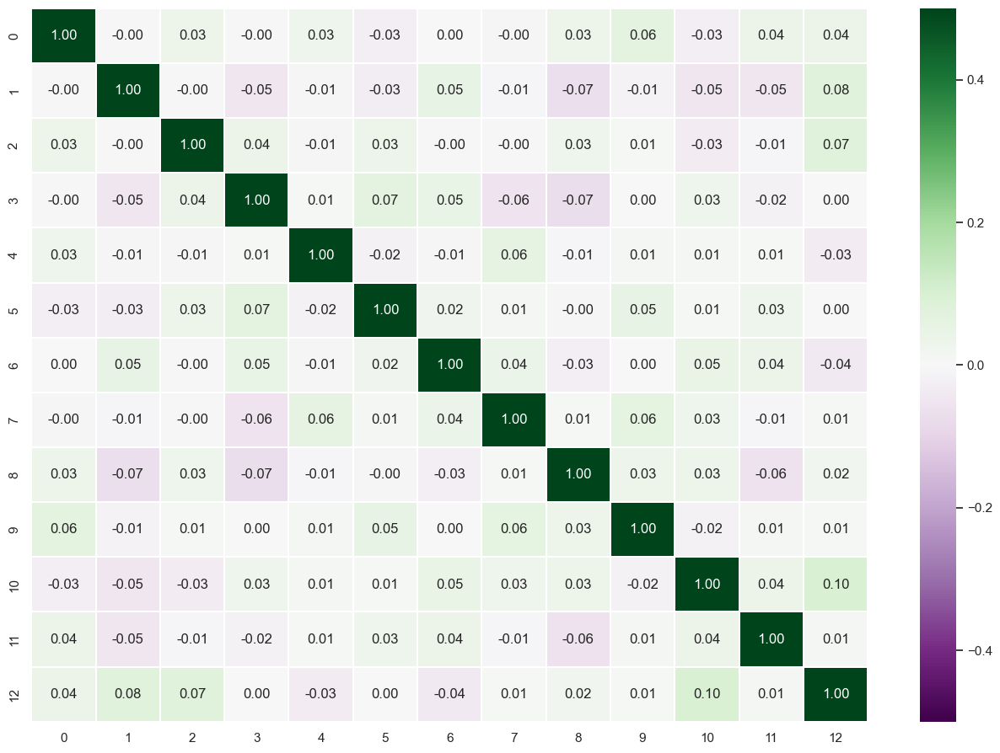

In [312]:
# Тепловая карта
corr = stnd_minx_res.corr()
fig, ax = plt.subplots(figsize=(16, 11))
sns.heatmap(corr, vmin=-0.5, vmax=0.5, annot=True, fmt='.2f',cmap='PRGn', ax=ax, linewidths = 0.1)
plt.show()
# наблюдается зависимость между Плостностью и углом нашивки
# но она довольно слабая

In [18]:
# После проведенной работы сохраняем готовый датасет.

df_n.to_excel('./data/X_cln.xlsx')


In [132]:
# Обратный перевод
#result = scaler.inverse_transform(df_n)
#initial_data = pd.DataFrame(result, columns = df_n.columns)
#initial_data.head(5)

Модели для прогноза модуля упругости при растяжении и прочности при растяжении.



In [17]:
#Визуализация предсказанных значений целевых переменных
def predicted_plot(y_test, y_pred, model_name):
  plt.figure(figsize=(15,9))
  plt.title(f'Тестовые и прогнозные значения: {model_name}')
  plt.plot(y_test.to_numpy()[:,0], label='Тест')
  plt.plot(y_pred[:,0], label='Прогноз')
  plt.legend(loc='best')
  plt.ylabel('н')
  plt.xlabel('Порядок')

  plt.figure(figsize=(15,9))
  plt.title(f'Тестовые и прогнозные значения: {model_name}')
  plt.plot(y_test.to_numpy()[:,1], label='Тест')
  plt.plot(y_pred[:,1], label='Прогноз')
  plt.legend(loc='best')
  plt.ylabel('н')
  plt.xlabel('Порядок')
def predicted_ns(y_test, y_pred):
  plt.figure(figsize=(15,9))
  plt.title(f'Тест и прогноз, Соотношение М-Н: ')
  plt.plot(y_test.to_numpy(), label='Тест')
  plt.plot(y_pred, label='Прогноз')
  plt.legend(loc='best')
  plt.ylabel('н')
  plt.xlabel('Порядок')

Загрузка данных из файла сохранения 

In [231]:
df_n = pd.read_excel('./data/X_cln.xlsx')
df_n.drop(['Unnamed: 0'], axis=1, inplace=True)

In [232]:
df_n.shape

(936, 13)

Входы и выходы для моделей

In [184]:
y_label = ['Модуль упругости при растяжении, ГПа', 'Прочность при растяжении, МПа']
y = df_n[y_label]
X = df_n.drop(y_label, axis = 1)
y.shape,X.shape


((936, 2), (936, 11))

Разделяем датасет на обучающую и тестовую выборки


In [185]:
X_train, X_test, y_train,y_test = train_test_split(X, y , test_size=0.3, random_state=42)




Линейная регрессия


In [187]:
X_train.dropna().shape, y_train.shape

((655, 11), (655, 2))

In [213]:
# модуль упругости при растяжении и прочность
del loss_df

loss_df =pd.DataFrame([])

linear_model = LinearRegression()
linear_model.fit(X_train,  y_train)
y_pred = linear_model.predict(X_test)


model_name = 'Linear Regression'

# датасет ошибок

loss_df = pd.DataFrame(columns=['target','model','MSE','MAE','MAPE','R2'])

def add_loss(loss_df, model_name):
    MSE = mean_squared_error(y_test, y_pred)
    MAE = mean_absolute_error(y_test, y_pred)
    MAPE = mean_absolute_percentage_error(y_test, y_pred)
    R2 = r2_score(y_test, y_pred)
    df_n = pd.DataFrame({'model':model_name,\
                                'target':['Модуль упругости и Прочность'],\
                                'MSE':MSE,\
                                'MAE':MAE,\
                                'MAPE':MAPE,\
                                'R2':R2})
  
    loss_df = pd.concat([loss_df, df_n],ignore_index=True)
    return loss_df

loss_df = add_loss(loss_df, model_name)


In [214]:
loss_df

,target,model,MSE,MAE,MAPE,R2
0,Модуль упругости и Прочность,Linear Regression,0.035074,0.150041,0.462999,-0.024522


Визуализация

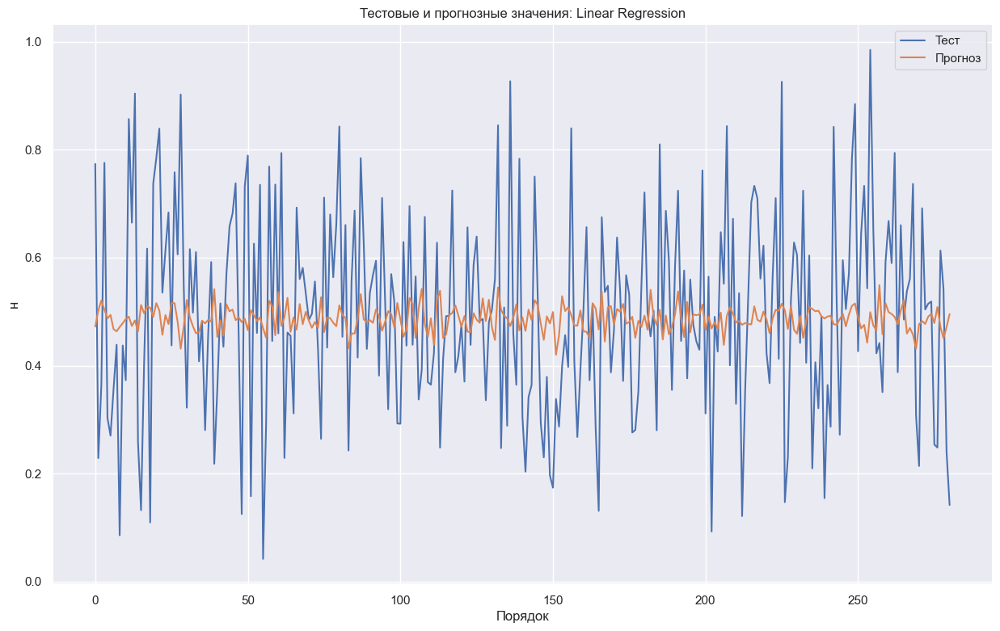

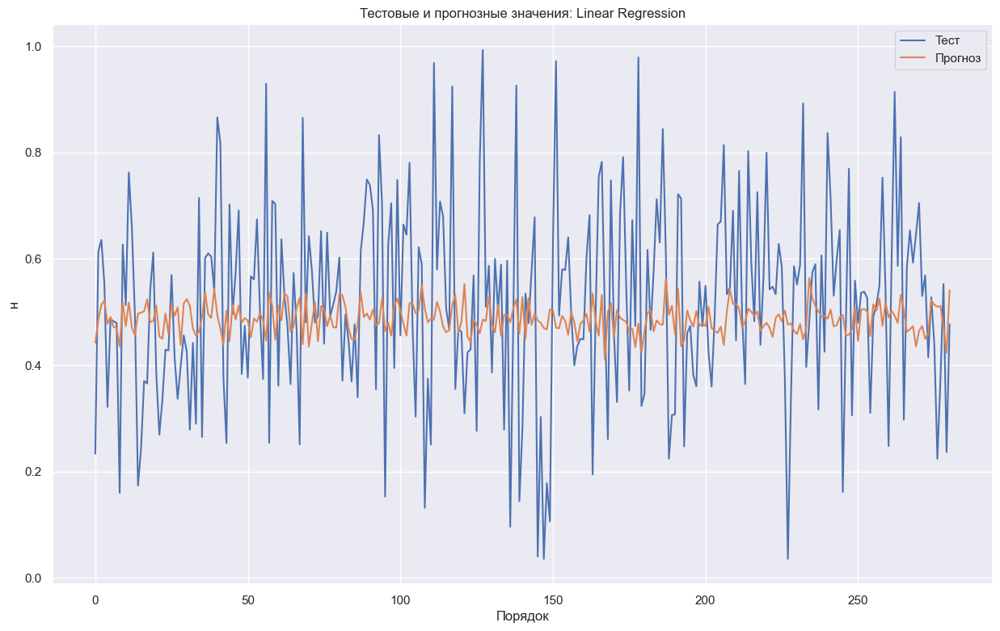

In [343]:
predicted_plot(y_test, y_pred, model_name)

Регрессия k-ближайших соседей


In [216]:
model = KNeighborsRegressor()
grid = {'n_neighbors' : range(1, 101, 1), 
          'weights' : ['uniform', 'distance'],
          'algorithm' : ['auto', 'ball_tree', 'kd_tree', 'brute']
          }

gsc1 = GridSearchCV(model, grid, n_jobs=-1, cv=5,verbose = 1)
gsc1.fit(X_train,  y_train)
model = gsc1.best_estimator_


model_name = 'KNeighborsRegressor'
loss_df = add_loss(loss_df,model_name)


Fitting 5 folds for each of 800 candidates, totalling 4000 fits


In [217]:
loss_df

,target,model,MSE,MAE,MAPE,R2
0,Модуль упругости и Прочность,Linear Regression,0.035074,0.150041,0.462999,-0.024522
1,Модуль упругости и Прочность,KNeighborsRegressor,0.035074,0.150041,0.462999,-0.024522


Визуализация

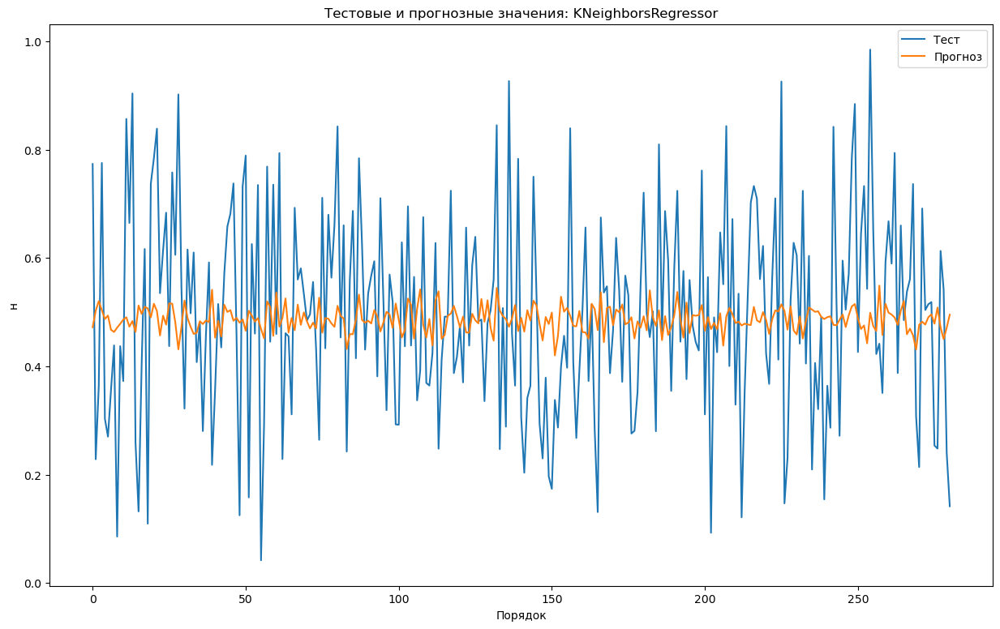

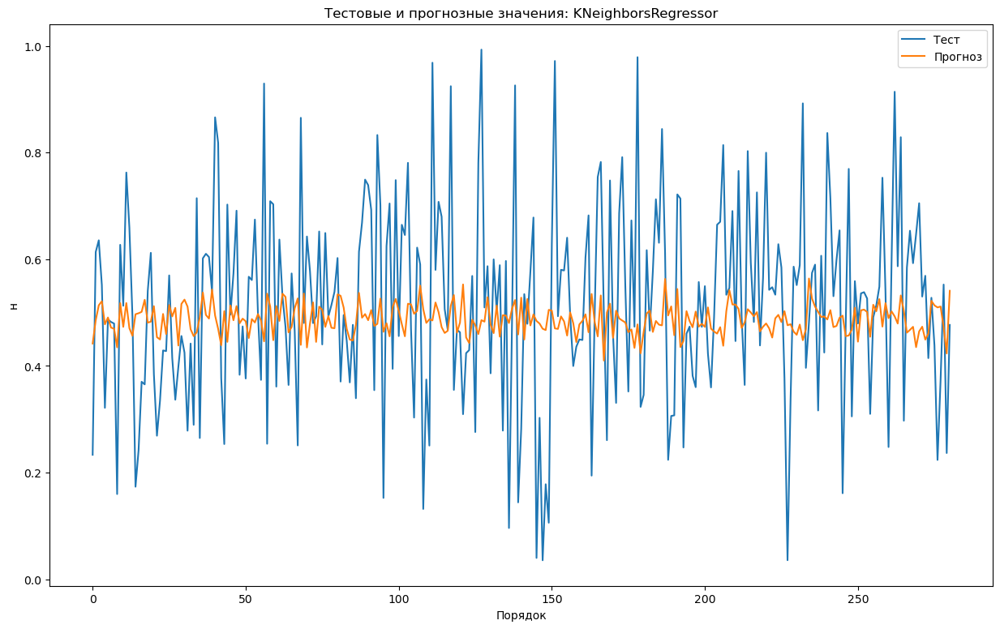

In [61]:
predicted_plot(y_test, y_pred,model_name)

svr

In [218]:
from sklearn.svm import SVR
from sklearn.multioutput import MultiOutputRegressor
grid = {
    'estimator__C':np.arange(1.0,5.5,0.5),
    'estimator__epsilon':np.arange(0.1,1.1,0.1)}

model = MultiOutputRegressor(SVR())
gsc = GridSearchCV(model, grid, n_jobs=-1, cv=10)
gsc.fit(X_train,  y_train)
model = gsc.best_estimator_

model_name = 'SVR'
loss_df = add_loss(loss_df,model_name)


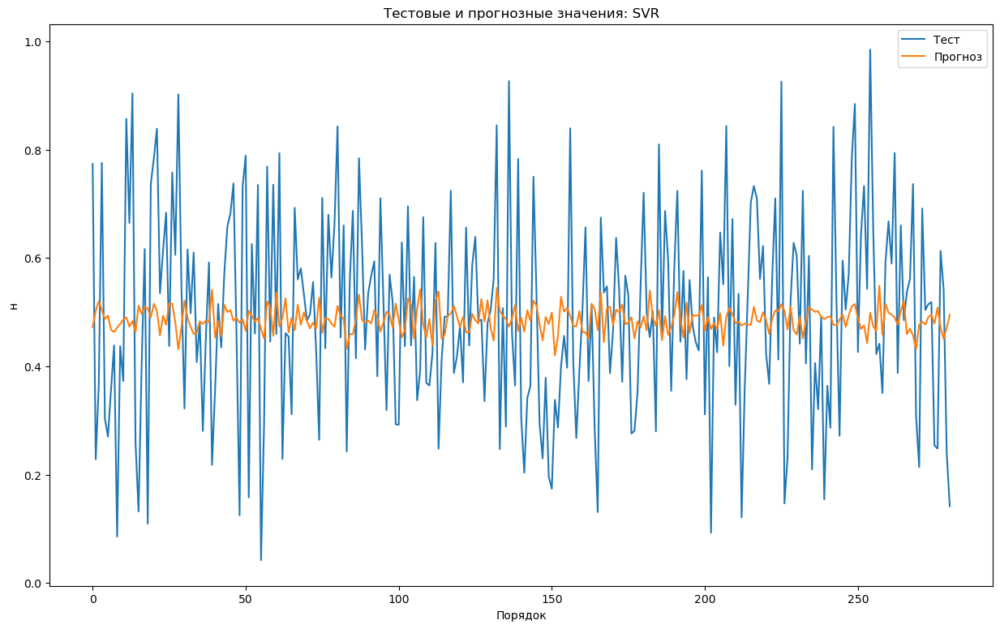

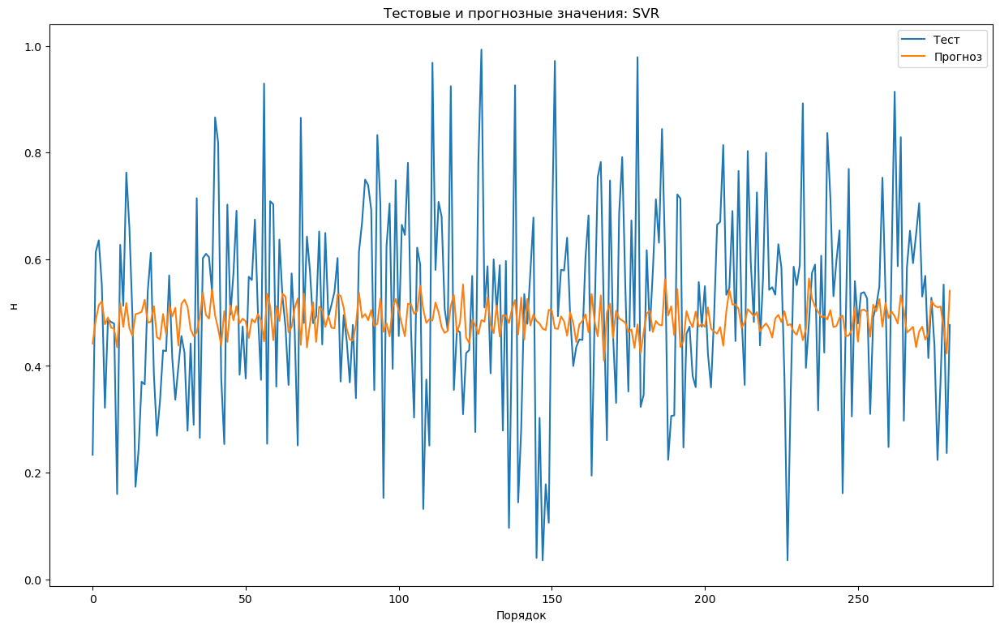

In [65]:
predicted_plot(y_test, y_pred,model_name)

In [219]:
loss_df

,target,model,MSE,MAE,MAPE,R2
0,Модуль упругости и Прочность,Linear Regression,0.035074,0.150041,0.462999,-0.024522
1,Модуль упругости и Прочность,KNeighborsRegressor,0.035074,0.150041,0.462999,-0.024522
2,Модуль упругости и Прочность,SVR,0.035074,0.150041,0.462999,-0.024522


In [228]:
from sklearn.ensemble import RandomForestRegressor

#Случайный лес

dtr2 = RandomForestRegressor()
dtr2.fit(X_train, y_train.values)
y_pred = dtr2.predict(X_test)


model_name = 'RandomForestRegressor'
loss_df = add_loss(loss_df,model_name)



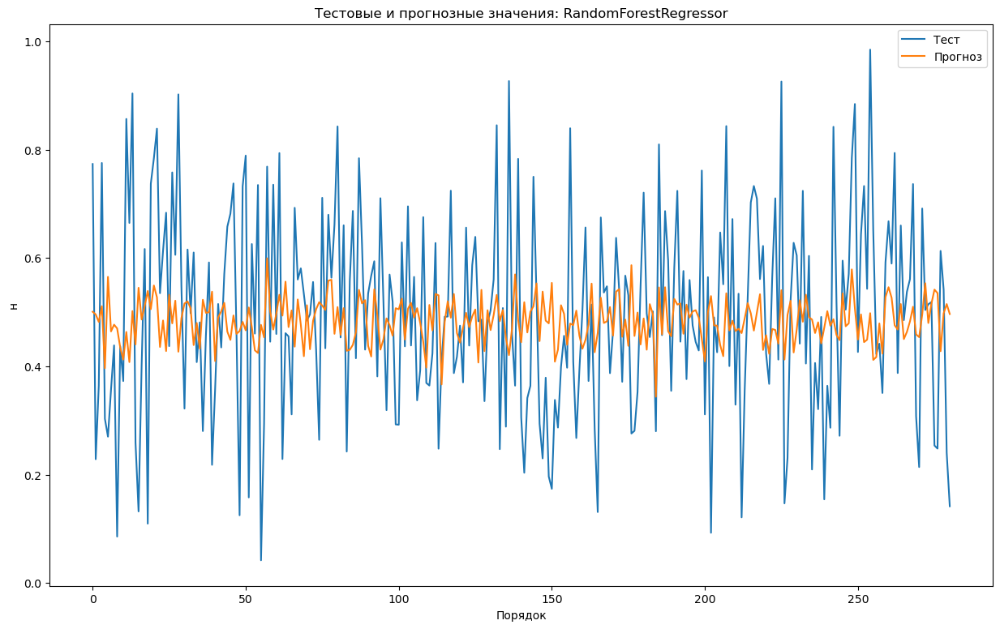

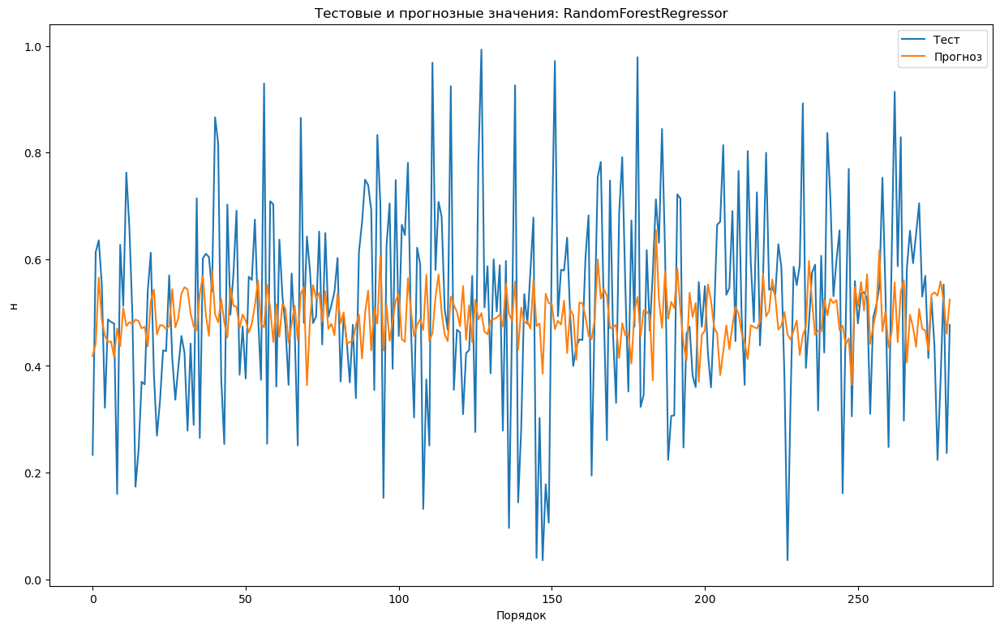

In [100]:
predicted_plot(y_test, y_pred,model_name)

In [222]:
loss_df

,target,model,MSE,MAE,MAPE,R2
0,Модуль упругости и Прочность,Linear Regression,0.035074,0.150041,0.462999,-0.024522
1,Модуль упругости и Прочность,KNeighborsRegressor,0.035074,0.150041,0.462999,-0.024522
2,Модуль упругости и Прочность,SVR,0.035074,0.150041,0.462999,-0.024522
3,Модуль упругости и Прочность,RandomForestRegressor,0.035518,0.152109,0.465148,-0.037449
4,Модуль упругости и Прочность,RandomForestRegressor,0.035087,0.149829,0.459059,-0.024902


In [280]:
#Случайный лес

check=1 #Позиция

x = np.expand_dims(X_train.iloc[check], axis=0)
res = dtr2.predict(x)
print(y_train.iloc[check])
print(res)
print(res)

Модуль упругости при растяжении, ГПа    0.478061
Прочность при растяжении, МПа           0.366735
Name: 756, dtype: float64
[[0.46515224 0.41989247]]
[[0.46515224 0.41989247]]


Рекомендательная нейросеть для соотношения матрица-наполнитель


In [302]:
df_n = pd.read_excel('./data/X_cln.xlsx')
df_n.drop(['Unnamed: 0'], axis=1, inplace=True)

df_n.shape

(936, 13)

In [303]:
y = df_n['Соотношение матрица-наполнитель']
X = df_n.drop(['Соотношение матрица-наполнитель'], axis = 1)


# Разбиваем выборки на обучающую и тестовую
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state = 14)
# Нормализуем данные

x_train_n = tf.keras.layers.Normalization(axis =-1)
x_train_n.adapt(np.array(x_train))

y.shape,X.shape

((936,), (936, 12))

In [304]:
from tensorflow.keras.layers import Dense

In [377]:

model1 = tf.keras.Sequential([x_train_n, layers.Dense(12, activation='relu'),  
                                                 layers.Dense(128, activation='relu'),
                                                 layers.Dense(64, activation='relu'), 
                                                 layers.Dense(32, activation='tanh'), 
                                                 layers.Dense(1)
                            ])



In [373]:
model1.compile(optimizer = 'adam', loss = 'mean_squared_error', metrics = ['mae'])  
# Посмотрим на архитектуру модели

model1.summary()
history1 = model1.fit(
    x_train, 
    y_train, 
    epochs = 300, 
    validation_split = 0.2)




Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
normalization_1 (Normalizati (None, 12)                25        
_________________________________________________________________
dense_108 (Dense)            (None, 12)                156       
_________________________________________________________________
dense_109 (Dense)            (None, 128)               1664      
_________________________________________________________________
dense_110 (Dense)            (None, 64)                8256      
_________________________________________________________________
dense_111 (Dense)            (None, 32)                2080      
_________________________________________________________________
dense_112 (Dense)            (None, 1)                 33        
Total params: 12,214
Trainable params: 12,189
Non-trainable params: 25
________________________________________________

18/18 [==============================] - 0s 4ms/step - loss: 0.0036 - mae: 0.0470 - val_loss: 0.0617 - val_mae: 0.2031
Epoch 55/300
18/18 [==============================] - 0s 3ms/step - loss: 0.0036 - mae: 0.0479 - val_loss: 0.0636 - val_mae: 0.2024
Epoch 56/300
18/18 [==============================] - 0s 4ms/step - loss: 0.0027 - mae: 0.0409 - val_loss: 0.0658 - val_mae: 0.2057
Epoch 57/300
18/18 [==============================] - 0s 4ms/step - loss: 0.0028 - mae: 0.0422 - val_loss: 0.0666 - val_mae: 0.2072
Epoch 58/300
18/18 [==============================] - 0s 5ms/step - loss: 0.0023 - mae: 0.0364 - val_loss: 0.0674 - val_mae: 0.2100
Epoch 59/300
18/18 [==============================] - 0s 4ms/step - loss: 0.0020 - mae: 0.0341 - val_loss: 0.0665 - val_mae: 0.2077
Epoch 60/300
18/18 [==============================] - 0s 5ms/step - loss: 0.0019 - mae: 0.0332 - val_loss: 0.0657 - val_mae: 0.2083
Epoch 61/300
18/18 [==============================] - 0s 4ms/step - loss: 0.0022 - mae: 0

18/18 [==============================] - 0s 4ms/step - loss: 6.6932e-04 - mae: 0.0201 - val_loss: 0.0673 - val_mae: 0.2093
Epoch 116/300
18/18 [==============================] - 0s 4ms/step - loss: 5.3096e-04 - mae: 0.0182 - val_loss: 0.0683 - val_mae: 0.2113
Epoch 117/300
18/18 [==============================] - 0s 4ms/step - loss: 6.3772e-04 - mae: 0.0195 - val_loss: 0.0692 - val_mae: 0.2112
Epoch 118/300
18/18 [==============================] - 0s 4ms/step - loss: 6.2642e-04 - mae: 0.0191 - val_loss: 0.0665 - val_mae: 0.2093
Epoch 119/300
18/18 [==============================] - 0s 4ms/step - loss: 6.5556e-04 - mae: 0.0199 - val_loss: 0.0709 - val_mae: 0.2134
Epoch 120/300
18/18 [==============================] - 0s 5ms/step - loss: 8.8341e-04 - mae: 0.0225 - val_loss: 0.0677 - val_mae: 0.2092
Epoch 121/300
18/18 [==============================] - 0s 5ms/step - loss: 0.0011 - mae: 0.0249 - val_loss: 0.0684 - val_mae: 0.2100
Epoch 122/300
18/18 [==============================] - 0s 5

18/18 [==============================] - 0s 4ms/step - loss: 3.6561e-04 - mae: 0.0148 - val_loss: 0.0694 - val_mae: 0.2118
Epoch 176/300
18/18 [==============================] - 0s 4ms/step - loss: 3.4676e-04 - mae: 0.0146 - val_loss: 0.0667 - val_mae: 0.2058
Epoch 177/300
18/18 [==============================] - 0s 4ms/step - loss: 8.2459e-04 - mae: 0.0216 - val_loss: 0.0686 - val_mae: 0.2091
Epoch 178/300
18/18 [==============================] - 0s 5ms/step - loss: 0.0012 - mae: 0.0263 - val_loss: 0.0676 - val_mae: 0.2104
Epoch 179/300
18/18 [==============================] - 0s 4ms/step - loss: 0.0012 - mae: 0.0261 - val_loss: 0.0677 - val_mae: 0.2107
Epoch 180/300
18/18 [==============================] - 0s 4ms/step - loss: 8.7847e-04 - mae: 0.0226 - val_loss: 0.0685 - val_mae: 0.2095
Epoch 181/300
18/18 [==============================] - 0s 4ms/step - loss: 0.0010 - mae: 0.0243 - val_loss: 0.0663 - val_mae: 0.2091
Epoch 182/300
18/18 [==============================] - 0s 4ms/step 

18/18 [==============================] - 0s 4ms/step - loss: 6.8453e-05 - mae: 0.0063 - val_loss: 0.0662 - val_mae: 0.2050
Epoch 236/300
18/18 [==============================] - 0s 3ms/step - loss: 1.0641e-04 - mae: 0.0080 - val_loss: 0.0658 - val_mae: 0.2042
Epoch 237/300
18/18 [==============================] - 0s 4ms/step - loss: 1.1854e-04 - mae: 0.0085 - val_loss: 0.0669 - val_mae: 0.2061
Epoch 238/300
18/18 [==============================] - 0s 4ms/step - loss: 1.1331e-04 - mae: 0.0082 - val_loss: 0.0669 - val_mae: 0.2065
Epoch 239/300
18/18 [==============================] - 0s 4ms/step - loss: 9.2854e-05 - mae: 0.0074 - val_loss: 0.0665 - val_mae: 0.2060
Epoch 240/300
18/18 [==============================] - 0s 4ms/step - loss: 1.3189e-04 - mae: 0.0088 - val_loss: 0.0668 - val_mae: 0.2059
Epoch 241/300
18/18 [==============================] - 0s 4ms/step - loss: 1.5398e-04 - mae: 0.0096 - val_loss: 0.0673 - val_mae: 0.2064
Epoch 242/300
18/18 [==============================] - 

18/18 [==============================] - 0s 4ms/step - loss: 4.7075e-04 - mae: 0.0164 - val_loss: 0.0647 - val_mae: 0.2037
Epoch 296/300
18/18 [==============================] - 0s 4ms/step - loss: 4.7375e-04 - mae: 0.0163 - val_loss: 0.0646 - val_mae: 0.2037
Epoch 297/300
18/18 [==============================] - 0s 4ms/step - loss: 6.2641e-04 - mae: 0.0194 - val_loss: 0.0653 - val_mae: 0.2045
Epoch 298/300
18/18 [==============================] - 0s 4ms/step - loss: 5.3913e-04 - mae: 0.0178 - val_loss: 0.0659 - val_mae: 0.2045
Epoch 299/300
18/18 [==============================] - 0s 5ms/step - loss: 4.7251e-04 - mae: 0.0168 - val_loss: 0.0630 - val_mae: 0.2011
Epoch 300/300
18/18 [==============================] - 0s 5ms/step - loss: 5.6282e-04 - mae: 0.0182 - val_loss: 0.0659 - val_mae: 0.2055


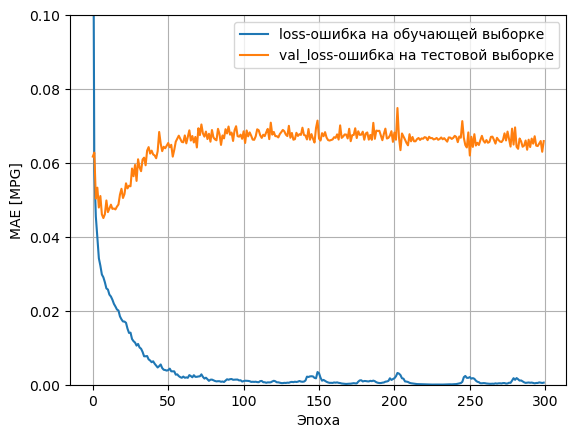

In [374]:
def plot_loss(history):
    plt.plot(history.history['loss'], label='loss-ошибка на обучающей выборке')
    plt.plot(history.history['val_loss'], label='val_loss-ошибка на тестовой выборке')
    plt.ylim([0, 0.1])
    plt.xlabel('Эпоха')

    plt.ylabel('MAE [MPG]')
    plt.legend()
    plt.grid(True)
    
model_hist1 = plot_loss(history1)


Визуализация


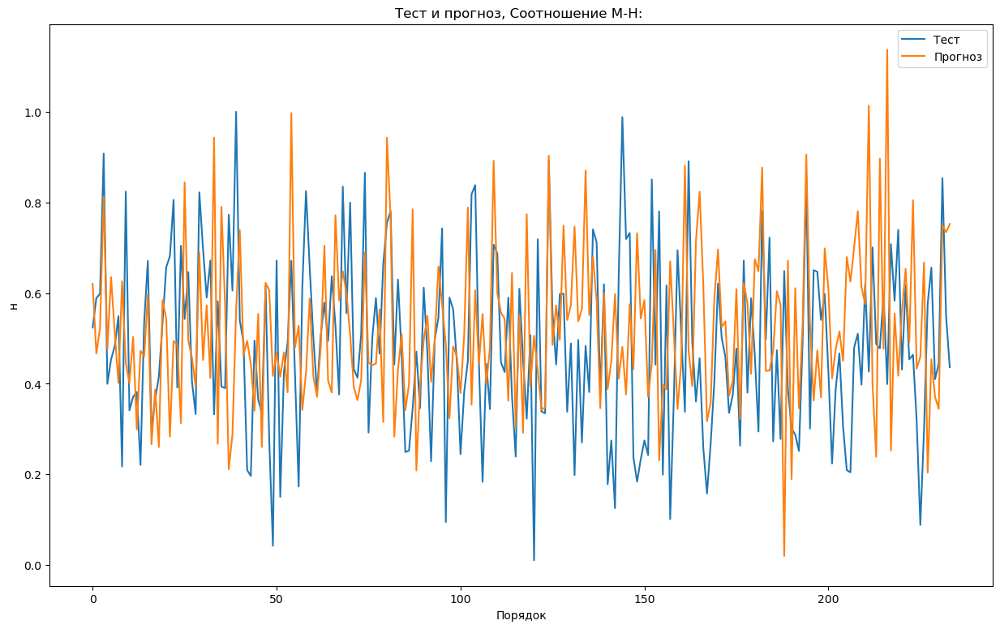

In [375]:
#  факт/прогноз для результата модели
#  Посмотрим на график результата работы модели
predicted_p = predicted_ns(y_test, model1.predict(x_test))


Оценка MSE


In [376]:
model1.evaluate(x_test, y_test, verbose=1)

8/8 [==============================] - 0s 2ms/step - loss: 0.0621 - mae: 0.1996


[0.062136344611644745, 0.19958464801311493]

In [347]:
model2 = tf.keras.Sequential([x_train_n, layers.Dense(12, input_dim=13, activation='relu'),  
                                                 layers.Dense(128, activation='relu'), 
                                                 layers.Dense(64, activation='relu'), 
                                                 layers.Dense(10, activation='relu'), 
                                                 layers.Dense(1)
                            ])



In [348]:
model2.compile(optimizer = 'adam', loss = 'mean_squared_error', metrics = ['mae'])  
# Посмотрим на архитектуру модели

model2.summary()
history2 = model2.fit(
    x_train, 
    y_train, 
    epochs = 50, 
    validation_split = 0.2)



Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
normalization_1 (Normalizati (None, 12)                25        
_________________________________________________________________
dense_82 (Dense)             (None, 12)                156       
_________________________________________________________________
dense_83 (Dense)             (None, 128)               1664      
_________________________________________________________________
dense_84 (Dense)             (None, 64)                8256      
_________________________________________________________________
dense_85 (Dense)             (None, 10)                650       
_________________________________________________________________
dense_86 (Dense)             (None, 1)                 11        
Total params: 10,762
Trainable params: 10,737
Non-trainable params: 25
________________________________________________

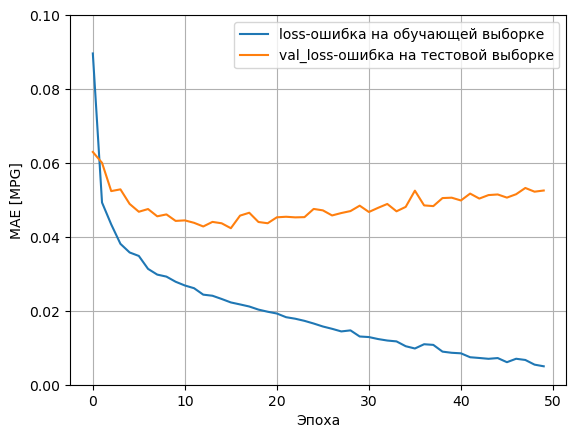

In [349]:
model_hist2 = plot_loss(history2)


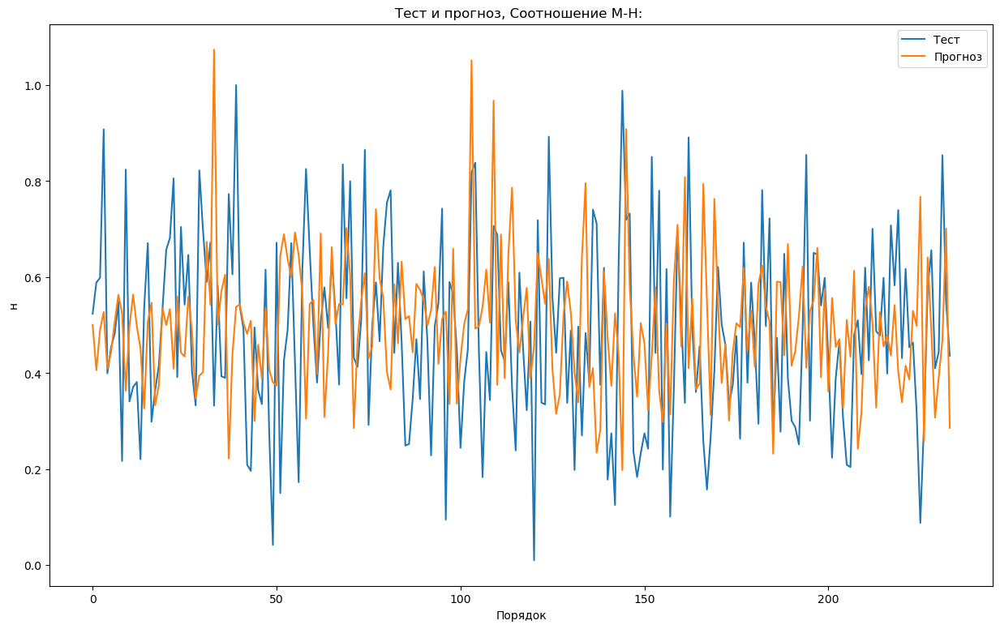

In [350]:
#  факт/прогноз для результата модели
#  Посмотрим на график результата работы модели
predicted_p2 = predicted_ns(y_test, model2.predict(x_test))


In [358]:
#Сравнение двух моделей
model1.evaluate(x_test, y_test, verbose=1)
model2.evaluate(x_test, y_test, verbose=1)

8/8 [==============================] - 0s 2ms/step - loss: 0.0541 - mae: 0.1837


[0.05410754680633545, 0.1836579144001007]

In [352]:
#model1.predict(x_test(1))
#model2.predict(x_test.head(1))


In [298]:
from sklearn.ensemble import RandomForestRegressor

df_n = pd.read_excel('./data/X_cln.xlsx')
df_n.drop(['Unnamed: 0'], axis=1, inplace=True)
y_label = ['Модуль упругости при растяжении, ГПа', 'Прочность при растяжении, МПа']
y = df_n[y_label]
X = df_n.drop(y_label, axis = 1)
y.shape,X.shape
X_train, X_test, y_train,y_test = train_test_split(X, y , test_size=0.3, random_state=42)


X_train.dropna().shape, y_train.shape

#Случайный лес

dtr2 = RandomForestRegressor()
dtr2.fit(X_train, y_train.values)
y_pred = dtr2.predict(X_test)


-------------------Приложение-------------------------
Ведите цифру в диапазоне от1 до 100 для просмотра
расчета Модуля упругости при растяжении и прочность при растяжении предсказанную машинным обучением

In [301]:
check=input() #Позиция в датасете и расчет Модуль упругости при растяжении и прочность при растяжении

----------------------------------

In [300]:
x = np.expand_dims(X_train.iloc[check], axis=0)
res = dtr2.predict(x)
print(y_train.iloc[check])
print(res)
print(res)
X_test[(check-1):check]

Модуль упругости при растяжении, ГПа    0.504710
Прочность при растяжении, МПа           0.726325
Name: 693, dtype: float64
[[0.51010653 0.65665012]]
[[0.51010653 0.65665012]]


,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
70,0.292155,0.490983,0.758573,0.37546,0.493904,0.544581,0.43753,0.501841,0,0.67237,0.227022
